In [1]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity
from sentence_transformers import SentenceTransformer   
import textwrap
import seaborn as sns
import preamble
import torch
import src.constants as const
import statsmodels.formula.api as smf

/Users/Quirin/Documents/QDS/data literacy/dataliteracy25/src/constants.py:11: SyntaxWarning: invalid escape sequence '\&'
  "PSE/S\&D": "#E41A1C",


In [2]:
MODEL_NAME = "google/embeddinggemma-300m" # previously chosen embedding model
OUTDATED_MODELS = ["jinaai/jina-embeddings-v3",
            "jinaai/jina-embeddings-v4",
            "Snowflake/snowflake-arctic-embed-l-v2.0",
            "BAAI/bge-m3", 
            'sentence-transformers/all-MiniLM-L6-v2', 
            'sentence-transformers/all-mpnet-base-v2',
            'Qwen/Qwen3-Embedding-0.6B']

In [3]:
# import dataframe of migration speeches with embeddings
df = pd.read_parquet("data/speech_embeddings.parquet")

In [4]:
# delete all columns of outdated models to save memory
for outdated_model in OUTDATED_MODELS:
    if outdated_model in df.columns:
        del df[outdated_model]

In [5]:
# inspect the dataframe
df.head()

,Unnamed: 0,speaker,text,date,agenda,speechnumber,procedure_ID,partyfacts_ID,period,chair,...,written,multispeaker,link,translatedText,translationSource,year,block,party,migration_prob,google/embeddinggemma-300m
492,492,Karen Melchior,"Mr President, thank you very much to the Commi...",2024-04-24,22. Advance passenger information: enhancing a...,8,bill_26075_ID bill_26076_ID bill_26075_ID bi...,6401.0,9,False,...,False,False,https://www.europarl.europa.eu/doceo/document/...,"Mr President, thank you very much to the Commi...",original_gm,2024,liberal,ELDR/ALDE/Renew,0.393282,"[-0.06368264, -0.01790871, 0.008169121, 0.0173..."
844,844,Tineke Strik,"Mr President, Commissioner. People who flee wa...",2024-04-23,17. EU-Egypt strategic and comprehensive partn...,9,,6403.0,9,False,...,False,False,https://www.europarl.europa.eu/doceo/document/...,"Mr President, Commissioner. People who flee wa...",original_gm,2024,green,Greens/EFA,0.423501,"[-0.06358229, 0.05332363, -0.006831329, 0.0041..."
1050,1050,Anabela Rodrigues,"Senhora Presidente, em 2024, o tráfico de sere...",2024-04-22,20. Amending Directive 2011/36/EU on preventin...,10,bill_241_ID bill_241_ID,6402.0,9,False,...,False,False,https://www.europarl.europa.eu/doceo/document/...,"Madam President, in 2024, human trafficking co...",machine_gm,2024,left,NGL/The Left,0.375925,"[-0.049918693, -0.001202861, -0.008896867, -0...."
1054,1054,Beata Kempa,Pani Przewodnicząca! Pani Komisarz! Potrzebuje...,2024-04-22,20. Amending Directive 2011/36/EU on preventin...,14,bill_241_ID bill_241_ID,6400.0,9,False,...,False,False,https://www.europarl.europa.eu/doceo/document/...,"Madam Commissioner! We need very specific, ver...",machine_gm,2024,(extreme)_right,ECR,0.256493,"[-0.035047594, 0.03835739, -0.051198084, 0.050..."
1056,1056,Dorien Rookmaker,"Voorzitter, dank u wel, meneer Engerer, want u...",2024-04-22,20. Amending Directive 2011/36/EU on preventin...,16,bill_241_ID bill_241_ID,6400.0,9,False,...,False,False,https://www.europarl.europa.eu/doceo/document/...,"Madam President, thank you, Mr Engerer, becaus...",machine_gm,2024,(extreme)_right,ECR,0.475315,"[-0.06766452, 0.015919995, -0.019874139, -0.01..."


In [6]:
# load the google embedding model
device = "cuda" if torch.cuda.is_available() else "mps" if torch.mps.is_available() else "cpu" 
model = SentenceTransformer(MODEL_NAME, trust_remote_code=True).to(device)

In [7]:
# hard-code migration narratives identified in Seiger et al., 2025 (Report from Joint Research Centre of the European Commission)
queries_jrc = {
    "immigrants_as_problematic" : 
    [
    "Immigration is a threat to the European way of life and identity",
    "Arabs and Muslims are a cultural or social threat",
    "Certain immigrants are unwilling or incapable to integrate"],
    "immigrants_as_threat":
    [
    "Immigration is a threat to individual safety",
    "Immigration is a threat to national security",
    "Immigrants are prone to committing crimes (violent, non-violent, organised, sexual)",
    "Many immigrants are terrorists",
    "Immigrants spread diseases"],
    "immigrants_as_burden":
    [
    "Immigrants do not contribute to the economy",
    "Immigrants take our jobs",
    "Many asylum seekers are actually economic migrants",
    "Immigrants receive better benefits than natives",
    "Immigrants abuse the welfare system",
    "Immigrants are a strain on our health-care system",
    "Immigrants are a strain on the housing market",
    "Immigration reduces the attractiveness of location and lowers overall life quality",
    "Receiving immigrants is too expensive / immigration burdens tax payers"
    ],
    "immigrants_as_victims": 
    ["Immigrants are victims of false hope",
    "Immigrants are victims of human traffickers",
    "EU does not have the means to properly take care of immigrants, therefore it is better for them not to come here",
    "Certain immigrants or asylum seekers are discriminated against",
    "EU is in breach of international law (e.g. inadequate reception facilities, refoulement at the borders, prolonged asylum procedures)",
    "Immigrants suffer from labour exploitation"
    ],
    "us_vs_them": 
    ["EU is harmful for our nation",
    "Let’s overthrow the establishment",
    "Political rivals act against the interests of the people",
    "Political rivals' policy failed",
    "Our sovereignty is under threat"
    ]
}
queries_jrc_flat = [query for category_queries in queries_jrc.values() for query in category_queries]  

In [8]:
# embed jrc queries
query_embeddings = model.encode(queries_jrc_flat, batch_size=32, normalize_embeddings=True, prompt_name="Retrieval-query")

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [9]:
# compute cosine similarity between query embeddings and speech embeddings for every speech
for i, query_embedding in enumerate(query_embeddings):
    column_name = queries_jrc_flat[i]
    df[column_name] = df[MODEL_NAME].apply(lambda x: cosine_similarity([query_embedding], [x])[0][0])

In [10]:
def top_speeches(df, query, n=5):
    '''Prints the top n speeches that have the highest cosine similarity to the query'''
    if query not in df.columns:
        print(f"Query '{query}' not found in dataframe columns, computing embedding..." )
        query_embedding = model.encode_query([query], batch_size=1)[0]
        df[query] = df[MODEL_NAME].apply(lambda x: cosine_similarity([query_embedding], [x])[0][0])
    top = df.nlargest(n, query)
    print(f"Top {n} speeches for query: '{query}'")
    for _, row in top.iterrows():
        print(f"{row['speaker']}  (sim={row[query]:.4f})")
        print(textwrap.fill(row['translatedText'], width=90))
        print()
    print("--------------------------------------------------\n")

In [11]:
for query in queries_jrc_flat:
    top_speeches(df, query, n=5)

Top 5 speeches for query: 'Immigration is a threat to the European way of life and identity'
Mireille D'Ornano  (sim=0.5732)
The migration crisis that we have been experiencing for many months and whose proportions
are becoming exponential is not a crisis of welcoming refugees. Many of these illegal
migrants are not political refugees but illegal immigrants who came to Europe because
complicit national governments and the European Union opened the doors for economic and
political reasons. This migratory torrent is accompanied by media sirens, praise from the
press and professionals of indignation and good conscience. Yes, welcoming hundreds of
thousands of illegal immigrants every month on our soil is a betrayal of the people of
Europe who will be the first to suffer the disastrous consequences of this mass arrival of
populations. Who will finance emergency facilities? What accommodation will be available?
What jobs will we be able to offer? The plan to establish quotas is the most fla

## Plot cosine similarities for every party over time

In [12]:
def mean_similarity_plots(ax, df, query):
    if query not in df.columns:
        print(f"Query '{query}' not found in dataframe columns, computing embedding..." )
        query_embedding = model.encode_query([query], batch_size=1)[0]
        df[query] = df[MODEL_NAME].apply(lambda x: cosine_similarity([query_embedding], [x])[0][0])
    sns.lineplot(data=df, x='year', y=query, hue='block', marker='o', palette=const.COLOR_MAP_BLOCK, ax=ax, errorbar='ci')
    ax.set_title(query[:60] + ("..." if len(query) > 60 else ""))
    ax.set_ylabel("Mean Cosine Similarity")
    ax.set_xlabel("Year")
    # ax.legend(title='Party Block')
    ax.grid(True)

In [13]:
queries = queries_jrc_flat
fig, axes = plt.subplots(len(queries)//2, 2, figsize=(12, 4 * len(queries)//2))
for ax, query in zip(axes.flatten(), queries):
    mean_similarity_plots(ax, df, query)
plt.tight_layout()
plt.show()

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
/var/folders/6q/pqc7tgjx0_nfs5rp04gzmt640000gn/T/ipykernel_58422/2701048088.py:5: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


In [14]:
# compute average similarity for each category
for category, category_queries in queries_jrc.items():
    df[category] = df[category_queries].mean(axis=1)

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
/var/folders/6q/pqc7tgjx0_nf

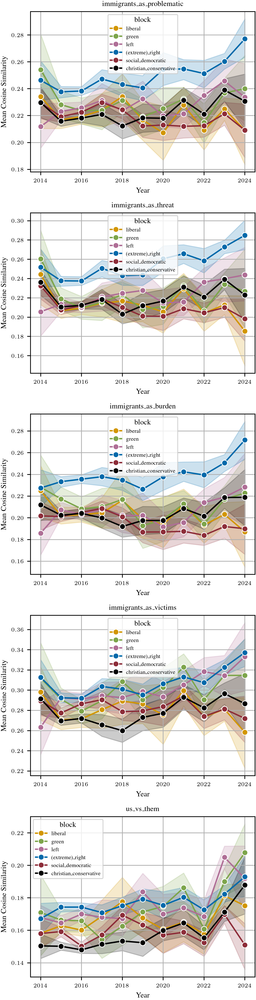

In [15]:
fig, axes = plt.subplots(5, 1, figsize=(4, 15))
for ax, category in zip(axes, queries_jrc.keys()):
    sns.lineplot(data=df, x='year', y=category, hue='block', marker='o', palette=const.COLOR_MAP_BLOCK, ax=ax, errorbar='ci')
    ax.set_title(category[:60] + ("..." if len(category) > 60 else ""))
    ax.set_ylabel("Mean Cosine Similarity")
    ax.set_xlabel("Year")
    # ax.legend(title='Party Block')
    ax.grid(True)

plt.tight_layout()
plt.show()

In [16]:
df.head()

,Unnamed: 0,speaker,text,date,agenda,speechnumber,procedure_ID,partyfacts_ID,period,chair,...,EU is harmful for our nation,Let’s overthrow the establishment,Political rivals act against the interests of the people,Political rivals' policy failed,Our sovereignty is under threat,immigrants_as_problematic,immigrants_as_threat,immigrants_as_burden,immigrants_as_victims,us_vs_them
492,492,Karen Melchior,"Mr President, thank you very much to the Commi...",2024-04-24,22. Advance passenger information: enhancing a...,8,bill_26075_ID bill_26076_ID bill_26075_ID bi...,6401.0,9,False,...,0.309955,0.026456,0.091261,0.126133,0.175092,0.248565,0.282140,0.264482,0.358132,0.145779
844,844,Tineke Strik,"Mr President, Commissioner. People who flee wa...",2024-04-23,17. EU-Egypt strategic and comprehensive partn...,9,,6403.0,9,False,...,0.373491,0.186330,0.206929,0.167115,0.251574,0.265039,0.257980,0.242387,0.349258,0.237088
1050,1050,Anabela Rodrigues,"Senhora Presidente, em 2024, o tráfico de sere...",2024-04-22,20. Amending Directive 2011/36/EU on preventin...,10,bill_241_ID bill_241_ID,6402.0,9,False,...,0.280711,0.074460,0.099808,0.056425,0.167611,0.235208,0.280927,0.253220,0.393233,0.135803
1054,1054,Beata Kempa,Pani Przewodnicząca! Pani Komisarz! Potrzebuje...,2024-04-22,20. Amending Directive 2011/36/EU on preventin...,14,bill_241_ID bill_241_ID,6400.0,9,False,...,0.284024,0.129964,0.071580,0.015403,0.170343,0.177064,0.189430,0.152514,0.288895,0.134263
1056,1056,Dorien Rookmaker,"Voorzitter, dank u wel, meneer Engerer, want u...",2024-04-22,20. Amending Directive 2011/36/EU on preventin...,16,bill_241_ID bill_241_ID,6400.0,9,False,...,0.275449,0.194140,0.130465,0.084247,0.225779,0.228920,0.260638,0.240080,0.309574,0.182016


## Construct linear mixed model

In [17]:
for category in queries_jrc.keys():
    print(f"Fitting mixed effects model for category: {category}")
    model = smf.mixedlm(
        f"{category} ~ year * block",
        data=df,
        groups="block",
        re_formula="~year"
    )

    result = model.fit(method="lbfgs")
    print(f"Results for category: {category}")
    print(result.summary())
    print("\n")

Fitting mixed effects model for category: immigrants_as_problematic
Results for category: immigrants_as_problematic
                     Mixed Linear Model Regression Results
Model:                MixedLM   Dependent Variable:   immigrants_as_problematic
No. Observations:     9705      Method:               REML                     
No. Groups:           6         Scale:                0.0025                   
Min. group size:      483       Log-Likelihood:       15323.5520               
Max. group size:      2638      Converged:            Yes                      
Mean group size:      1617.5                                                   
-------------------------------------------------------------------------------
                                     Coef.  Std.Err.   z    P>|z| [0.025 0.975]
-------------------------------------------------------------------------------
Intercept                            -5.475    0.762 -7.188 0.000 -6.969 -3.982
block[T.christian_conserv

/Users/Quirin/anaconda3/envs/dlit/lib/python3.12/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/Users/Quirin/anaconda3/envs/dlit/lib/python3.12/site-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/Users/Quirin/anaconda3/envs/dlit/lib/python3.12/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/Users/Quirin/anaconda3/envs/dlit/lib/python3.12/site-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/Users/Quirin/anaconda3/envs/dli

Results for category: immigrants_as_burden
                     Mixed Linear Model Regression Results
Model:                 MixedLM     Dependent Variable:     immigrants_as_burden
No. Observations:      9705        Method:                 REML                
No. Groups:            6           Scale:                  0.0033              
Min. group size:       483         Log-Likelihood:         13871.2492          
Max. group size:       2638        Converged:              Yes                 
Mean group size:       1617.5                                                  
-------------------------------------------------------------------------------
                                     Coef.  Std.Err.   z    P>|z| [0.025 0.975]
-------------------------------------------------------------------------------
Intercept                            -3.453    0.885 -3.902 0.000 -5.187 -1.718
block[T.christian_conservative]       2.386    1.320  1.808 0.071 -0.201  4.972
block[T.green]    

/Users/Quirin/anaconda3/envs/dlit/lib/python3.12/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/Users/Quirin/anaconda3/envs/dlit/lib/python3.12/site-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/Users/Quirin/anaconda3/envs/dlit/lib/python3.12/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/Users/Quirin/anaconda3/envs/dlit/lib/python3.12/site-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


In [18]:
# save dataframe with computed similarities
df.to_parquet("data/final/migration_with_similarities.parquet")

### Failed Test: Pro - anti contrast axes

In [19]:
# anti_immigration_axis = {
#     "pro": [
#         "Immigration is bad",
#         "Immigrants’ identity or culture is problematic",
#         "Immigration is a threat to the European way of life and identity",
#         "Arabs and Muslims are a cultural or social threat",
#         "Certain immigrants are unwilling or incapable to integrate",
#         "Immigration is a threat to individual safety",
#         "Immigration is a threat to national security",
#         "Immigrants are prone to committing crimes (violent, non-violent, organised, sexual)",
#         "Many immigrants are terrorists",
#         "Immigrants spread diseases",
#         "There are too many immigrants coming",
#         "Immigrants do not contribute to the economy",
#         "Immigrants take our jobs",
#         "Many asylum seekers are actually economic migrants",
#         "Immigrants abuse the welfare system",
#         "Immigrants are a strain on our health-care system",
#         "Immigrants are a strain on the housing market",
#         "Immigration reduces the attractiveness of location and lowers overall life quality",
#         "Receiving immigrants is too expensive/ immigration burdens tax payers"
#     ],
#     "anti": [
#         "Immigration is not bad",
#         "Immigrants’ identity or culture is not problematic",
#         "Immigration is not a threat to the European way of life and identity",
#         "Arabs and Muslims are not a cultural or social threat",
#         "Most immigrants are willing and able to integrate",
#         "Immigration is not a threat to individual safety",
#         "Immigration is not a threat to national security",
#         "Immigrants are not more prone to committing crimes than others",
#         "Immigrants are not terrorists",
#         "Immigrants do not spread diseases",
#         "The number of immigrants is manageable",
#         "Immigrants contribute to the economy",
#         "Immigrants do not take jobs from others",
#         "Most asylum seekers are genuine refugees",
#         "Immigrants do not abuse the welfare system",
#         "Immigrants are not a strain on the health-care system",
#         "Immigrants are not a strain on the housing market",
#         "Immigration does not reduce quality of life",
#         "Receiving immigrants is not too expensive and does not overly burden taxpayers"
#     ]
# }


In [20]:
# pro_texts = anti_immigration_axis["pro"]
# anti_texts = anti_immigration_axis["anti"] 
# axes = {}

# for i, (pro, anti) in enumerate(zip(pro_texts, anti_texts)):
#     pro_emb = model.encode_query(pro, normalize_embeddings=True)
#     anti_emb = model.encode_query(anti, normalize_embeddings=True)

#     axis = pro_emb - anti_emb
#     axis /= np.linalg.norm(axis)

#     axes[i] = {
#         "pro": pro,
#         "anti": anti,
#         "axis": axis
#     }

In [21]:
# speech_embeddings = np.vstack(df[MODEL_NAME].values)
# for i, axis in enumerate(axes.values()):
#     column_name = pro_texts[i]
#     df[column_name] = np.array([emb @ axis["axis"] for emb in speech_embeddings])

In [22]:
# pro_embeddings = model.encode_query(anti_immigration_axis["pro"], batch_size=32)
# anti_embeddings = model.encode_query(anti_immigration_axis["anti"], batch_size=32)
# axis = np.mean(pro_embeddings, axis=0) - np.mean(anti_embeddings, axis=0)
# axis = axis / np.linalg.norm(axis)  # unit length

# # for every embedding, compute its axis
# for embedding 
# axis = np.mean(pro_embeddings, axis=0) - np.mean(anti_embeddings, axis=0)
# axis = axis / np.linalg.norm(axis)  # unit length

In [23]:
# queries = pro_texts
# fig, axes = plt.subplots(len(queries)//2, 2, figsize=(12, 4 * len(queries)//2))
# for ax, query in zip(axes.flatten(), queries):
#     mean_similarity_plots(ax, df, query)
#     # on first pass, set legend
#     if ax == axes.flatten()[0]:
#         ax.legend(title='Party Block')

# plt.tight_layout()
# plt.show()